# Statistical analysis of speech sound chirpiness

In [1]:
import Pkg
Pkg.activate("..")
import WCA1

 Activating environment at `/mnt/data/L2S/myWCA1/Project.toml`


In [2]:
import WAV
x, fs = WAV.wavread("../samples/speech_signal_example.wav")
x = reshape(x, length(x))
X = WCA1.stft(x, 1000, 900; fs=fs, window=WCA1.hanning)

# chirpiness matrix
VV = WCA1.compute_chirpiness(X)
V = reshape(VV, length(VV))

# slope matrix
slope_mat, z = WCA1.slopes(X, -5, 5, 500)
slope = z[Int.(slope_mat[slope_mat .!== nothing])];

## Distribution Plots

Helper functions for plotting distributions

In [3]:
using Distributions, StatsBase, HypothesisTests, LinearAlgebra
using Plots

histo(data, nbins=Int(ceil(sqrt(length(data))))) = fit(Histogram, data; closed=:right, nbins=nbins)
proba(distribution, a, b) = cdf(distribution, b) - cdf(distribution, a)
mid_range(bins) = first(bins)+0.5*step(bins):step(bins):last(bins)-0.5*step(bins)

function plot_histogram_pdf(h::Histogram, d::D) where {D<:UnivariateDistribution}
    mid_bins = mid_range(h.edges[1])
    plot(normalize(h, mode=:pdf), label="histogram")
    plot!(mid_bins, pdf.(d, mid_bins), color="red", label="probability distribution function")
end

function plot_data_cdf(data::Vector{T}, d::D) where {T<:Real, D<:UnivariateDistribution}
    sorted = ecdf(data).sorted_values
    plot(sorted, range(0, stop=1, length=length(sorted)), label="empirical distribution function")
    plot!(sorted, cdf.(d, sorted), color="red", label="cumulative distribution function")
end

plot_data_cdf (generic function with 1 method)

Generate and visualize pdf and cdf

In [4]:
normal(data::Vector{T}) where {T<:Real} = Normal(mean(data), std(data))
cauchy(data::Vector{T}) where {T<:Real} = Cauchy(median(data), median(abs.(data)))

cauchy (generic function with 1 method)

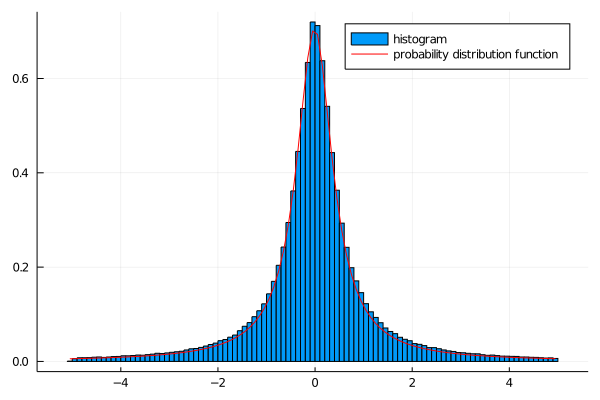

In [5]:
slope_dist = cauchy(slope)
plot_histogram_pdf(histo(slope, 100), slope_dist)

In [7]:
plot_data_cdf(slope, slope_dist)

We can see that the plots diverge at the edges, this can be explained by the fact that slope values are filtered in the `WCA1.compute_slope_matrix` function called by `WCA1.slopes`.

Let's see if the unfiltered values fit the Cauchy distribution values better.

In [8]:
Vdist = cauchy(V)
plot_data_cdf(V, Vdist)

The values appear to fit.
Let's test the hypothesis.

## Tests

In order to test if the chirpiness values fit the Cauchy distribution.
We apply two different tests, both of which employ the *Empirical Cumulative Function* of the data and compare it with the Cumulative Distribution Function (of the Cauchy distribution).

In this section we call the `HypothesisTests.jl` library from *JuliaStats*.

### Kolmogorov–Smirnov Test

In [9]:
ExactOneSampleKSTest(slope, slope_dist)

┌ Warning: This test is inaccurate with ties
└ @ HypothesisTests /home/rand/.julia/packages/HypothesisTests/JapDD/src/kolmogorov_smirnov.jl:68


Exact one sample Kolmogorov-Smirnov test
----------------------------------------
Population details:
    parameter of interest:   Supremum of CDF differences
    value under h_0:         0.0
    point estimate:          0.0287317

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-99

Details:
    number of observations:   716418


In [10]:
ExactOneSampleKSTest(V, Vdist)

┌ Warning: This test is inaccurate with ties
└ @ HypothesisTests /home/rand/.julia/packages/HypothesisTests/JapDD/src/kolmogorov_smirnov.jl:68


Exact one sample Kolmogorov-Smirnov test
----------------------------------------
Population details:
    parameter of interest:   Supremum of CDF differences
    value under h_0:         0.0
    point estimate:          0.00454132

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-13

Details:
    number of observations:   767031


### Anderson–Darling Test

In [11]:
OneSampleADTest(slope, slope_dist)

One sample Anderson-Darling test
--------------------------------
Population details:
    parameter of interest:   not implemented yet
    value under h_0:         NaN
    point estimate:          NaN

Test summary:
    outcome with 95% confidence: reject h_0
    one-sided p-value:           <1e-9

Details:
    number of observations:   716418
    sample mean:              -0.0011690871952134657
    sample SD:                1.2183651893061715
    A² statistic:             1767.5566257988303


In [12]:
OneSampleADTest(V, Vdist)

One sample Anderson-Darling test
--------------------------------
Population details:
    parameter of interest:   not implemented yet
    value under h_0:         NaN
    point estimate:          NaN

Test summary:
    outcome with 95% confidence: reject h_0
    one-sided p-value:           <1e-9

Details:
    number of observations:   767031
    sample mean:              0.002505214201901581
    sample SD:                38.93504851347296
    A² statistic:             48.93442798706488


Let's draw values from the cauchy distribution and apply the same tests on the data. We expect to accept the null hypothesis.

In [14]:
using Random
Random.seed!(123)
test_vals = rand(Vdist, length(V))
test_dist = cauchy(test_vals)

Cauchy{Float64}(μ=0.00016600077844686984, σ=0.4949368103199442)

In [15]:
ExactOneSampleKSTest(test_vals, test_dist)

Exact one sample Kolmogorov-Smirnov test
----------------------------------------
Population details:
    parameter of interest:   Supremum of CDF differences
    value under h_0:         0.0
    point estimate:          0.000688797

Test summary:
    outcome with 95% confidence: fail to reject h_0
    two-sided p-value:           0.8599

Details:
    number of observations:   767031


In [16]:
OneSampleADTest(test_vals, test_dist)

One sample Anderson-Darling test
--------------------------------
Population details:
    parameter of interest:   not implemented yet
    value under h_0:         NaN
    point estimate:          NaN

Test summary:
    outcome with 95% confidence: fail to reject h_0
    one-sided p-value:           0.8218

Details:
    number of observations:   767031
    sample mean:              -0.05815307742545626
    sample SD:                222.32441523569858
    A² statistic:             0.4268342179176519


## Conclusions

### Results

Both tests reject the null hypothesis $H_0$ which postulates that the tested values are generated by a Cauchy distribution $\mathcal{C}(x_0,\gamma)$ where

- $x_0$ is estimated by the median of the data.
- $\gamma$ is estimated by the median of the absolute values of the data.

These parameter estimations are based on the
[Wikipedia article](https://en.wikipedia.org/wiki/Cauchy_distribution#Estimation_of_parameters)
and the
[Wolfram Alpha article](https://mathworld.wolfram.com/CauchyDistribution.html)
of the Cauchy distribution.

### Observations

The rejection of $H_0$ is somehow surprising given the fact that the plots seem to fit *visually*.
We can postulate the following:

- The `slope` values diverge at the edges since the values are heavily filtered.
- The `V` values diverge as they are unprocessed whatsoever and only a handful of these values are significant.

### Propositions

A less invasive processing of the initial slope values might be useful in our quest to match the values with a probability distribution (the Cauchy distribution in particular).

Do you agree?